##  Problem Statement

Classifying the tweets score `0`(negative) and `1`(positive)

### Data Source

Download the dataset from [here!](https://drive.google.com/file/d/1sWydQajja-EXNse0jq2SUn_FMk8xS95l/edit), extract and and save it to the `dataset/` directory. Also rename the test data as `test` and train data as `train`.

### Real World/Business Objectives and Constraints
- __Interpretability is important__. Because it is mandatory to know Why the tweets are positive or negative.

### Data Overview:

- __Train dataset contains 1.59M tweets containing 0.798M positive and 0.798M negative tweets.__
```
0    798468
4    798460
```

- __Test dataset contains 182 positive and 177 negative datapoints. (this is for preprocessed dataset. I've removed datapoints label `2` because this label was not present in the training dataset__
```
4    182
0    177
```

### Type of Machine Learning Problem

- This is Binary Classification (text)


### Metrics
- I will use `f1-score` to have hold on both precision and recall.
- I will also use `accuracy` and `confusion_matrix`.
- Plotting ROC-AUC Curve.


### Interpretation
- for Interpretation we will use [__LIME__](https://christophm.github.io/interpretable-ml-book/lime.html)(Local Interpretable Model Agnostic Explanation)
- We will also Interpret using TF-IDF weight in case of TF-IDF ML models

### Imports

In [1]:
import warnings 
warnings.filterwarnings("ignore") # ignore warnings

from time import time
import os
from tqdm import tqdm # to track the processing of loop 
import datetime as dt # to access date and time
import re # regular expression for preprocessing data
from pathlib import Path


import pandas as pd # data preprocessing
import numpy as np # numerical python processing(linear algebra)
import matplotlib.pyplot as plt # visualization
import seaborn as sns # Visualization on top of Matplotlib


from sklearn.feature_extraction.text import CountVectorizer # BOW=> Bag of Words
from sklearn.feature_extraction.text import TfidfVectorizer # TF-IDF=> Term-Frequency/ Inverse-Document Frequency
from sklearn.linear_model import LogisticRegression # Linear Model, Simple, and powerful
from sklearn.linear_model import SGDClassifier # using Optimization to minimize loss

# metrics to assess the model performance
from sklearn.metrics import f1_score, precision_score, recall_score


from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report 
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import roc_auc_score, roc_curve
from sklearn.model_selection import RepeatedStratifiedKFold, GridSearchCV


import pickle # to save model

### Loading preprocessed dataset

In [2]:
# data directory
data_dir = Path("../dataset")

In [3]:
# load train dataset
train = pd.read_csv(data_dir/"train_new.csv")
train.head()

,sentiment_score,tweet
0,0,that is a bummer You should a got David Carr o...
1,0,is upset that he can not update his Facebook b...
2,0,I dived many times for the ball Managed to sav...
3,0,my whole body feels itchy and like its on fire
4,0,no it is not behaving at i am mad why am i her...


In [4]:
# load test dataset
test = pd.read_csv(data_dir/"test_new.csv")
test.head()

,sentiment_score,tweet
0,1,I my Kindle 2 Not that the DX is cool but the ...
1,1,Reading my kindle 2 Love it childs is good read
2,1,Ok first asses ment of the kindle 2 it fucking...
3,1,You will love your Kindle 2 I have had mine fo...
4,1,Fair enough But i have the Kindle 2 and I thin...


### defining necessary helping function

#### Preprocessing function

In [5]:
from nltk.corpus import stopwords # standard stopwords to remove from dataset
from nltk.tokenize import word_tokenize # for tokenizing the sentence
from nltk.stem.snowball import SnowballStemmer # for stemming=> make words to their root using some rules
from nltk.stem import WordNetLemmatizer
import re

import nltk
nltk.download('punkt')

STOP_WORDS = stopwords.words('english')
STOP_WORDS.remove('not') # removing "not" from STOPWORDS because it make sense in context of sentiment

def preprocess(x):
    """
    this function preprocess the text including 
    1. replace abbreviations like won't=> will not
    2. stemming removing=> remov
    3. stop-word removal
    4. removing html tags
    """
    # typecast to lowercase
    x = str(x).lower()
    
    # initialize stemmer object
    snowball = SnowballStemmer(language='english')
    
    # lemmatizer
    lemmatizer = WordNetLemmatizer()
    
    # remove digits, if any
    x = re.sub(r'[0-9]', '', x)

    # tokenize the sentence into words
    words = word_tokenize(x) # It will return the list of words(tokens)
    
    # make final sentence including:
    # - stemming OR/AND lemmatization
    # - stopword removal  
    words = [
        lemmatizer.lemmatize(word) for word in words if word not in STOP_WORDS
    ] # list to store stemmed words
#     words = [
#         snowball.stem(word) for word in words if word not in STOP_WORDS
#     ] # list to store stemmed words
    
    
    return ' '.join(words)

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\modassir\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [6]:
preprocess("Hi, this is not cleaning bathing surprisingly playing played playerss cry")

'hi , not cleaning bathing surprisingly playing played player cry'

#### function to plot classification report
for both TRAIN and TEST dataset to get insight on Overfitting/Underfitting of the model
- __F1-score__
- __Classification report__
- __AUC Score__

In [7]:
def classification_report_custom(model, train_data, train_label, test_data, test_label, model_name="ML Model"):
    """This function shows the classification report of given model on the given dataset."""
    
    ################ TRAIN ERROR and ACCURACY ###################
    # prediction of test dataset using best given Model
    test_predicted = model.predict(test_data)
    train_predicted = model.predict(train_data)

    train_accuracy = accuracy_score(train_label, train_predicted)
    test_accuracy = accuracy_score(test_label, test_predicted)


    train_f1_score = f1_score(train_label, train_predicted)
    test_f1_score = f1_score(test_label, test_predicted)

    print("TRAIN Accuracy : ",train_accuracy)
    print("TEST Accuracy : ",test_accuracy)
    print("="*50)
    print("TRAIN f1-score : ",train_f1_score)
    print("TEST f1-score : ",test_f1_score)
    ###########################################################################

    ############### Classification RESULT of both Train, and Test dataset ######
    train_cf_report = classification_report(train_label, train_predicted)
    test_cf_report = classification_report(test_label, test_predicted)

    print("-------------------------")
    print("| Classification Report |")
    print("-------------------------")
    print("TRAIN : ")
    print(train_cf_report)
    print("TEST : ")
    print(test_cf_report)
    print("-------------------------")
    
    #############################################################################################

    ################### ROC-AUC Score ###########################################################
    # getting train_score, and test_score
    test_prob = model.predict_proba(test_data)[:,1]
    train_prob = model.predict_proba(train_data)[:,1]

    # area under the curve
    train_auc = roc_auc_score(train_label, train_prob)
    test_auc = roc_auc_score(test_label, test_prob)

    ns_probs_train = [0 for _ in range(len(train_label))] # no skill probability for train
    ns_probs_test = [0 for _ in range(len(test_label))] # no skill probability for test dataset

    ##########  TRAIN and TEST AUC  ###########
    fpr_train, tpr_train, _ = roc_curve(train_label, train_prob)
    fpr_test, tpr_test, _ = roc_curve(test_label, test_prob)

    ns_fpr, ns_tpr, _ = roc_curve(train_label, ns_probs_train) # this is for no-skill

    plt.plot(fpr_train,tpr_train,label='TRAIN AUC Score={}'.format(train_auc))
    plt.plot(fpr_test,tpr_test,label='TEST AUC Score={}'.format(test_auc))
    plt.plot(ns_fpr, ns_tpr, label='No skill')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title("TRAIN and TEST AUC Score of best {}".format(model_name))
    plt.legend() # to show the label on plot
    plt.show() # force to show the plot
    

### Preprocessing for TRAIN and TEST dataset

In [ ]:
t0 = time()
train["tweet"] = train["tweet"].apply(preprocess)
print(f"time taken to preprocess train data({train.shape[0]}): {time()-t0} s")
train.head()

In [ ]:
t0 = time()
test["tweet"] = test["tweet"].apply(preprocess)
print(f"time taken to preprocess train data({test.shape[0]}): {time()-t0} s")
test.head()

### Getting TF-IDF Vector

In [ ]:
def text_splitter(text):
    """
    this function split the text and return the list of splitted words
    """
    return text.split()

t0 = time()
tfidf_model_path = Path("../models/tfidf.pkl")
retrain = False
if tfidf_model_path.exists() and retrain is False:
    with open(tfidf_model_path, "rb") as tfidf_filepath:
        tfidf = pickle.load(tfidf_filepath)
else:
    # initializing TF-IDF object
    tfidf = TfidfVectorizer(
        smooth_idf=True,
        tokenizer = text_splitter,
    )
    # fitting it on train dataset
    tfidf.fit(train["tweet"])
    with open(tfidf_model_path, "wb") as tfidf_filepath:
        pickle.dump(tfidf, tfidf_filepath)
    print(f"time taken to fit and save TfidfVectorizer on train dataset: {time()-t0} s")

#### Getting tf-idf vector for both TRAIN and TEST

In [ ]:
# getting train and test tfidf vectors
t0 = time()
train_tfidf = tfidf.transform(train["tweet"])
print(f"time taken to get TRAIN tf-idf feature vector: {time()-t0} s")

t0 = time()
test_tfidf = tfidf.transform(test["tweet"])
print(f"time taken to get TEST tf-idf feature vector: {time()-t0} s")

In [ ]:
train_tfidf.shape, test_tfidf.shape

<pre>- 1M --> 327K -->43K features (this all happen due to preprocessing well)
- 43K features with stemming.
- 58K without stemming
- We can use LSA to reduce the dimension<pre>

In [ ]:
tfidf.get_feature_names()[11100:11150]

- Now the features seems to be meaningful after a lot of preprocessing

#### Let's see the Sparsity

In [ ]:
print(f"The sparsity is: {train_tfidf.nnz/np.prod(train_tfidf.shape, axis=0, dtype=np.float64):.8f}")

- The dataset is too much sparse. So, It is extremely needy to reduce the dimension.

### Reduce the dimensionality using LSA

In [ ]:
from sklearn.decomposition import TruncatedSVD
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import Normalizer

# As TruncatedSVD result is not Normalized, we'll Normalize the result also
lsa = make_pipeline(TruncatedSVD(n_components=100), Normalizer(copy=False))

t0 = time()
lsa_path = Path("../dataset/lsa.pkl")
retrain = True
if lsa_path.exists() and retrain is False:
    print("[INFO] Loading already fitted LSA...")
    with open(lsa_path, "rb") as lsa_filepath:
        lsa = pickle.load(lsa_filepath)
else:
    print("[INFO] Training LSA...")    
    lsa.fit(train_tfidf)
    with open(lsa_path, "wb") as lsa_filepath:
        pickle.dump(lsa, lsa_filepath)
explained_variance = lsa[0].explained_variance_ratio_.sum()
print(f"LSA for train data done in {time() - t0:.3f} s")
print(f"Explained variance of the SVD step: {explained_variance * 100:.1f}%")

In [ ]:
t0 = time()
train_lsa = lsa.transform(train_tfidf)
print(f"LSA for train data done in {time() - t0:.3f} s")

In [ ]:
t0 = time()
test_lsa = lsa.transform(test_tfidf)
print(f"LSA for test data done in {time() - t0:.3f} s")

### getting train and test labels

In [18]:
# getting train label and test label
train_labels = train["sentiment_score"]
test_labels = test["sentiment_score"]

### Visualize the data in 3D

In [19]:
# !pip install cufflinks plotly

In [20]:
# to visualize high-dimensional data into lower-dimension(2D)
import plotly.express as px
from sklearn.decomposition import PCA 
def visualize_data_3d(X, labels=None, path=None)->None:
    """
    this method takes high-dimensional data and change it into lower-dimension
    using PCA(3D) and plot the data in 3D using plotly.
    """
    pca = PCA(n_components=3, svd_solver="auto")
    components = pca.fit_transform(X)
    total_var = pca.explained_variance_ratio_.sum()*100
    
    X_pca = pd.DataFrame({"0":components[:,0], "1":components[:,1], "2": components[:,2]})
    
    fig = px.scatter_3d(
        components, x=0, y=1, z=2, color=labels,
        title=f"Total Explained Variance: {total_var:.2f}%",
        labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'},
    )
    if path is not None:
        fig.write_html(path)
    fig.show()

In [21]:
train_lsa.shape

(1600000, 100)

In [44]:
# t0 = time()
# visualize_data_3d(X_train, train_labels, path="../visualizations/data_3d.html")
# print(f"total time taken to get the visualization: {time()-t0} s")

## Train Logistic Regression model on LSA features

##### Split TRAIN data into TRAIN and Validation

In [45]:
from sklearn.model_selection import train_test_split

In [46]:
t0 = time()
X_train, X_val, y_train, y_val = train_test_split(train_lsa, train_labels, test_size=0.1, random_state=42, stratify=train_labels)
print(f"time taken to split the dataset into TRAIN and VAL part: {time()-t0} s")

time taken to split the dataset into TRAIN and VAL part: 3.833233594894409 s


In [47]:
X_train.shape, y_train.shape

((1440000, 100), (1440000,))

In [48]:
X_val.shape, y_val.shape

((160000, 100), (160000,))

##### Fit Logistic Regression


In [49]:
from sklearn.linear_model import LogisticRegression

# initialize LogisticRegression
lr_model = LogisticRegression()

# fit it on train data
t0 = time()
lr_model.fit(X_train, y_train)
print(f"time taken to train LogisticRegression model: {time() - t0} s")

time taken to train LogisticRegression model: 12.293699741363525 s


##### Classification report on Validation data

TRAIN Accuracy :  0.7094541666666667
TEST Accuracy :  0.7086
TRAIN f1-score :  0.7128879470664045
TEST f1-score :  0.712172656896275
-------------------------
| Classification Report |
-------------------------
TRAIN : 
              precision    recall  f1-score   support

           0       0.71      0.70      0.71    720000
           1       0.70      0.72      0.71    720000

    accuracy                           0.71   1440000
   macro avg       0.71      0.71      0.71   1440000
weighted avg       0.71      0.71      0.71   1440000

TEST : 
              precision    recall  f1-score   support

           0       0.71      0.70      0.70     80000
           1       0.70      0.72      0.71     80000

    accuracy                           0.71    160000
   macro avg       0.71      0.71      0.71    160000
weighted avg       0.71      0.71      0.71    160000

-------------------------


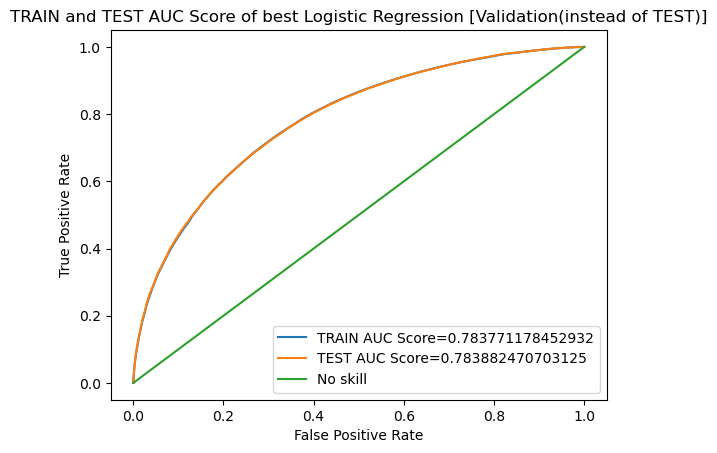

time taken to generate classification report: 5.709378242492676


In [52]:
t0=time()
classification_report_custom(
    model = lr_model,
    train_data = X_train,
    train_label = y_train,
    test_data = X_val,
    test_label = y_val,
    model_name="Logistic Regression [Validation(instead of TEST)]"
)
print(f"time taken to generate classification report: {time()-t0}")

TRAIN Accuracy :  0.7094541666666667
TEST Accuracy :  0.7353760445682451
TRAIN f1-score :  0.7128879470664045
TEST f1-score :  0.7594936708860759
-------------------------
| Classification Report |
-------------------------
TRAIN : 
              precision    recall  f1-score   support

           0       0.71      0.70      0.71    720000
           1       0.70      0.72      0.71    720000

    accuracy                           0.71   1440000
   macro avg       0.71      0.71      0.71   1440000
weighted avg       0.71      0.71      0.71   1440000

TEST : 
              precision    recall  f1-score   support

           0       0.78      0.64      0.71       177
           1       0.70      0.82      0.76       182

    accuracy                           0.74       359
   macro avg       0.74      0.73      0.73       359
weighted avg       0.74      0.74      0.73       359

-------------------------


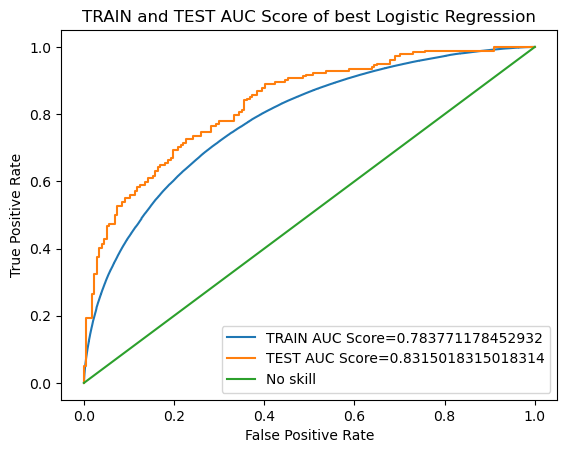

time taken to generate classification report: 5.299386024475098


In [55]:
t0=time()
classification_report_custom(
    model = lr_model,
    train_data = X_train,
    train_label = y_train,
    test_data = test_lsa,
    test_label = test_labels,
    model_name="Logistic Regression"
)
print(f"time taken to generate classification report: {time()-t0}")

__Save the model__

In [56]:
# saving the model for future use at given location
lr_model_path = "../models/lr_model.pkl"
with open(lr_model_path, "wb") as lr:
    pickle.dump(lr_model, lr)
    
# loading the model
with open(lr_model_path, 'rb') as lr:
    lr_model = pickle.load(lr)
lr_model

LogisticRegression()

__Summary of Logistic Regression model:__
- The model is not over-fitted.
- Test accuracy is `0.73` which is fair.
- Test macro f1-score is also `0.72` which is fair.

## Training Logistic Regression on TF-IDF features

In [57]:
lr_model_tfidf = LogisticRegression()
t0 = time()
lr_model_tfidf.fit(train_tfidf, train_labels)
print(f"time taken to train Logistic Regression on TF-IDF feautures: {time()-t0} s")

time taken to train Logistic Regression on TF-IDF feautures: 19.12460494041443 s


TRAIN Accuracy :  0.79073174705628
TEST Accuracy :  0.7966573816155988
TRAIN f1-score :  0.7944289522121061
TEST f1-score :  0.8113695090439277
-------------------------
| Classification Report |
-------------------------
TRAIN : 
              precision    recall  f1-score   support

           0       0.80      0.77      0.79    798090
           1       0.78      0.81      0.79    797680

    accuracy                           0.79   1595770
   macro avg       0.79      0.79      0.79   1595770
weighted avg       0.79      0.79      0.79   1595770

TEST : 
              precision    recall  f1-score   support

           0       0.84      0.73      0.78       177
           1       0.77      0.86      0.81       182

    accuracy                           0.80       359
   macro avg       0.80      0.80      0.80       359
weighted avg       0.80      0.80      0.80       359

-------------------------


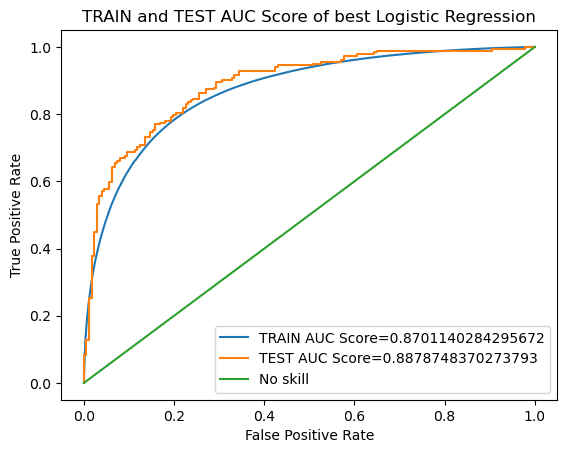

time taken to generate classification report: 5.5795300006866455


In [38]:
t0=time()
classification_report_custom(
    model = lr_model_tfidf,
    train_data = train_tfidf,
    train_label = train_labels,
    test_data = test_tfidf,
    test_label = test_labels,
    model_name="Logistic Regression"
)
print(f"time taken to generate classification report: {time()-t0}")

##### Saving tf-idf Logistic Regression Model

In [58]:
# saving the Logistic Regression tfidf model for future use at given location
with open("../models/lr_model_tfidf.pkl", 'wb') as lr_model_tfidf_file:
    pickle.dump(lr_model_tfidf, lr_model_tfidf_file)

__Summary of Logistic Regression on TF-IDF features:__
- The model is not overfitted.
- Test accuracy is `0.80`.
- Test micro f1-score.
- Test AUC score is `0.88`

### Feature Importance of Logistic Regression

In [59]:
def feature_importance_lr_tfidf(best_lr_model, tfidf):
    # get importance
    importance = best_lr_model.coef_[0]
    # get feature names using 
    features = tfidf.get_feature_names()
    
    feature_importance_lr = dict(zip(list(importance),list(features)))
    
    feature_importance_top = sorted(feature_importance_lr.items(),reverse=True)[:30]
    feature_importance_bottom = sorted(feature_importance_lr.items(),reverse=True)[-30:]
    
    print("Features which are contributing a lot to classify the tweet as 'positive'")
    for k in feature_importance_top:
        print(k)
    print("="*50)
    print("Features which are against to classify the tweet as 'negative'.")
    for k in feature_importance_bottom[::-1]:
        print(k) # just reversed 

In [60]:
feature_importance_lr_tfidf(lr_model_tfidf, tfidf)

Features which are contributing a lot to classify the tweet as 'positive'
(4.691093500699936, 'thank')
(4.642004423043555, 'smiling')
(4.576098697571176, 'relieve')
(4.538938431405424, 'thanks')
(4.514194760682273, 'smile')
(4.447791532483876, 'welcome')
(4.157383401724961, 'glad')
(3.987291732247608, 'congratulation')
(3.924451738869688, 'proud')
(3.8654332046656785, 'awesome')
(3.7851605320433466, 'congrats')
(3.7545410678909854, 'wait')
(3.7102981583461716, 'happy')
(3.6615730412037157, 'worry')
(3.6559539928554354, 'vip')
(3.6474642842949967, 'blessed')
(3.518027546125279, 'heh')
(3.5114303184078546, 'excited')
(3.439014520693392, 'pleasure')
(3.333334901852806, 'blessing')
(3.333034132080838, 'love')
(3.3168037679697284, 'great')
(3.2651045309272715, 'good')
(3.1930358947092135, 'thx')
(3.183425433711557, 'amusing')
(3.1743820733515205, 'loving')
(3.147418225154865, 'grin')
(3.1002773953310223, 'yay')
(3.0562600463448835, 'hello')
(3.048934631065966, 'relieved')
Features which are

__Interpreation summary:__
- TF-IDF vector features seems to be well.
- Positive features are: `thank`, `welcome`, `relieve`, `thanks`, `smile`, etc.
- Negative features are: `sad`, `poor`, `miss`, `sadly`, `missing`, etc.

### Interpret Logistic Regression using LIME

In [61]:
# !pip install lime

In [62]:
from lime.lime_text import LimeTextExplainer
def interpret_lr_tfidf(query):
    """
    This function interpret logistic Regression model using LIME on comment dataset.
    just pass the query.
    """
    # saved model path
    save_model_path = Path('../models')
    
    # typecasting to Series to be used by TfidfVectorizer
    query = pd.Series(preprocess(query)) # preprocess is a function to preprocess text
    
    # load saved models (TfidfVectorizer and Logistic Regression model)
    tfidf = pickle.load(open(save_model_path/"tfidf.pkl",'rb'))
    lr_model = pickle.load(open(save_model_path/"lr_model_tfidf.pkl",'rb'))
    
    # to be predicted classes
    classes = ['Negative','Positive']
    
    # create pipeline
    lr_pipeline = make_pipeline(tfidf, lr_model)
    
    # initialize LIME TEXT Expaliner
    lr_explainer = LimeTextExplainer(class_names = classes, bow=True)
    
    # explain given query using method explain_instance of lr_explainer
    lr_explained = lr_explainer.explain_instance(query[0], lr_pipeline.predict_proba)
    
    # show in the notebook
    lr_explained.show_in_notebook(text=True, predict_proba=True)

In [64]:
test.tail()

,sentiment_score,tweet
354,1,using latex lot typeset mathematics look hideous
355,0,note hate word hate page hate latex said hate ...
356,1,back real text editing environment latex
357,0,trouble iran iran iran far away
358,0,reading tweet coming iran whole thing terrifyi...


In [65]:
idx = 1
query = test.tweet.iloc[idx]
sentiment_score = test.sentiment_score.iloc[idx]
print(f"Query: {query} \nSentiment_score: {sentiment_score}")
interpret_lr_tfidf(query)

Query: reading kindle love child good read 
Sentiment_score: 1


In [66]:
idx = -1
query = test.tweet.iloc[idx]
sentiment_score = test.sentiment_score.iloc[idx]
print(f"Query: {query} \nSentiment_score: {sentiment_score}")
interpret_lr_tfidf(query)

Query: reading tweet coming iran whole thing terrifying incredibly sad 
Sentiment_score: 0


In [68]:
idx = -3
query = test.tweet.iloc[idx]
sentiment_score = test.sentiment_score.iloc[idx]
print(f"Query: {query} \nSentiment_score: {sentiment_score}")
interpret_lr_tfidf(query)

Query: back real text editing environment latex 
Sentiment_score: 1


In [69]:
interpret_lr_tfidf("I do not hate politics")

- Here I have written `I do not hate politics` But still It is giving us negative because the use of `hate` and `not`.
- Because TF-IDF is unable to capture the contextual understanding

## Multinomial Naive Bayes on TF-IDF vectorizer

time taken to train MultinomialNB on TF-IDF vectorizer: 0.2436082363128662
TRAIN Accuracy :  0.77062
TEST Accuracy :  0.766016713091922
TRAIN f1-score :  0.7705026694897766
TEST f1-score :  0.7741935483870969
-------------------------
| Classification Report |
-------------------------
TRAIN : 
              precision    recall  f1-score   support

           0       0.77      0.77      0.77    800000
           1       0.77      0.77      0.77    800000

    accuracy                           0.77   1600000
   macro avg       0.77      0.77      0.77   1600000
weighted avg       0.77      0.77      0.77   1600000

TEST : 
              precision    recall  f1-score   support

           0       0.78      0.74      0.76       177
           1       0.76      0.79      0.77       182

    accuracy                           0.77       359
   macro avg       0.77      0.77      0.77       359
weighted avg       0.77      0.77      0.77       359

-------------------------


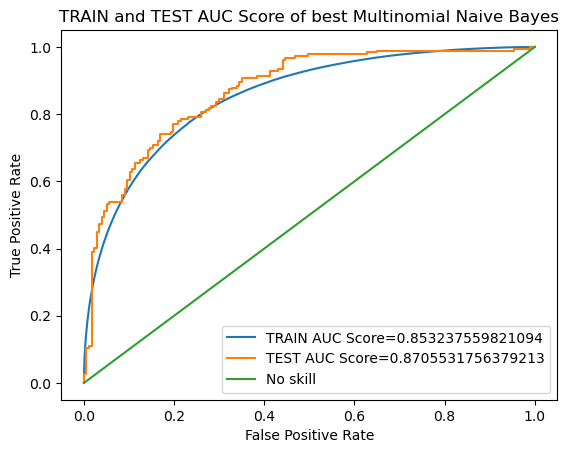

time taken to generate classification report: 5.11491847038269


In [70]:
from sklearn.naive_bayes import MultinomialNB

# initializing Multinomial Naive Bayes
mnb_model = MultinomialNB()

# Fitting the model on raw TF-IDF features instead of LSA features
t0 = time()
mnb_model.fit(train_tfidf, train_labels)
print(f"time taken to train MultinomialNB on TF-IDF vectorizer: {time()-t0}")

t0=time()
classification_report_custom(
    model = mnb_model,
    train_data = train_tfidf,
    train_label = train_labels,
    test_data = test_tfidf,
    test_label = test_labels,
    model_name="Multinomial Naive Bayes"
)
print(f"time taken to generate classification report: {time()-t0}")

### Saving the model

In [71]:
with open("../models/mnb_model.pkl",'wb') as mnb:
    pickle.dump(mnb_model, mnb)

### Feature Importance using MultinomialNB

In [72]:
# getting feature importance of BernoulliNB model
##################
# feature_log_prob_ : ndarray of shape (n_classes, n_features)
# Empirical log probability of features given a class, P(x_i|y).
##################
# ref/Credit : https://stackoverflow.com/questions/50526898/how-to-get-feature-importance-in-naive-bayes
def feature_importance_mnb(mnb_model):
    feature_importance_pos = np.exp(mnb_model.feature_log_prob_[1:][0])
    feature_importance_neg = np.exp(mnb_model.feature_log_prob_[0:][0])

    features = tfidf.get_feature_names()

    feature_importance_nb_pos = dict(zip(list(feature_importance_pos),list(features)))
    feature_importance_nb_neg = dict(zip(list(feature_importance_neg),list(features)))

    feature_importance_nb_positive = sorted(feature_importance_nb_pos.items(),reverse=True)[:50]
    feature_importance_nb_negative = sorted(feature_importance_nb_neg.items(),reverse=True)[-50:]

    print("Features which are contributing a lot to classify the story as comment using MultinomialNB")
    for p in feature_importance_nb_positive:
        print(p)
    print("="*50)

    print("Features which are against to classify the story as 'comment' using MultinomialNB.")
    for n in feature_importance_nb_negative:
        print(n)
    
feature_importance_mnb(mnb_model)

Features which are contributing a lot to classify the story as comment using MultinomialNB
(0.008110662626789977, 'good')
(0.006681558072069289, 'not')
(0.00660664991024041, 'love')
(0.006524589100891237, 'day')
(0.006369239808566493, 'thanks')
(0.006084371177103939, 'im')
(0.004962190004315644, 'u')
(0.004247046878792466, 'like')
(0.004107153793231254, 'time')
(0.004069152093448754, 'get')
(0.0038665215642112367, 'going')
(0.003701627640668658, 'morning')
(0.003698436016958753, 'go')
(0.003672877884072292, 'great')
(0.0036266844553459543, 'got')
(0.003610411693222838, 'today')
(0.0034643333911457907, 'know')
(0.0034463704051287485, 'one')
(0.003431874945616721, 'new')
(0.0033973220816835457, 'night')
(0.0033885826128364077, 'thank')
(0.0033310921857357166, 'happy')
(0.003325487516853627, 'twitter')
(0.0031065929540865893, 'well')
(0.0030327070649619195, 'back')
(0.0028419638277503746, 'fun')
(0.0027720747537308865, 'hope')
(0.0027248138582355416, 'work')
(0.0027062992961794092, 'nice'

__Summary of Feature Importance:__
- Positive features are good
- But negative features are not learned well. 
- This is not better than Logistic Regression

### Interpreting using LIME

In [73]:
def interpret_mnb_model(query):
    """
    This function interpret logistic Regression model using LIME on comment dataset.
    just pass the query.
    """
    # saved model path
    save_model_path = '../model_save/comment_data'
    # typecasting to Series to be used by TfidfVectorizer
    query = pd.Series(preprocess(query)) # preprocess is a function to preprocess text
    # load saved models (TfidfVectorizer and Logistic Regression model)
    tfidfVectorizer = pickle.load(open('../models/tfidf.pkl','rb'))
    
    mnb_model = pickle.load(open('../models/mnb_model.pkl','rb'))
    
    # to be predicted classes
    classes = ['Negative','Positive']
    
    # create pipeline
    mnb_pipeline = make_pipeline(
        tfidfVectorizer,
        mnb_model)
    # initialize LIME TEXT Expaliner
    mnb_explainer = LimeTextExplainer(class_names = classes, bow=True)
    
    # explain given query using method explain_instance of lr_explainer
    mnb_explained = mnb_explainer.explain_instance(query[0], mnb_pipeline.predict_proba)
    
    # show in the notebook
    mnb_explained.show_in_notebook(text=True, predict_proba=True)

In [79]:
idx = 1
query = test.tweet.iloc[idx]
sentiment_score = test.sentiment_score.iloc[idx]
print(f"Query: {query} \nSentiment_score: {sentiment_score}")
interpret_mnb_model(query)

Query: reading kindle love child good read 
Sentiment_score: 1


In [80]:
idx = -1
query = test.tweet.iloc[idx]
sentiment_score = test.sentiment_score.iloc[idx]
print(f"Query: {query} \nSentiment_score: {sentiment_score}")
interpret_mnb_model(query)

Query: reading tweet coming iran whole thing terrifying incredibly sad 
Sentiment_score: 0


In [81]:
idx = -2
query = test.tweet.iloc[idx]
sentiment_score = test.sentiment_score.iloc[idx]
print(f"Query: {query} \nSentiment_score: {sentiment_score}")
interpret_mnb_model(query)

Query: trouble iran iran iran far away 
Sentiment_score: 0


In [82]:
interpret_mnb_model("This is not fair")

In [83]:
interpret_mnb_model("It is very sad to know that you have stopped doing research on Computer Vision.")

In [84]:
interpret_mnb_model("It is really good to know the growth of AI in Indian Languages but it is also concerning to see the consequences of this.")

In [85]:
interpret_lr_tfidf("I hate politics")

In [86]:
interpret_lr_tfidf("I do not hate politics")

## Gaussian Naive Bayes 
- Will train Gaussian Naive Bayes on X_lsa LSA features.

time taken to fit the Gaussian NB model on train data: 4.093038558959961 s
TRAIN Accuracy :  0.6381881944444444
TEST Accuracy :  0.6384875
TRAIN f1-score :  0.6148681962763352
TEST f1-score :  0.614602489272674
-------------------------
| Classification Report |
-------------------------
TRAIN : 
              precision    recall  f1-score   support

           0       0.62      0.70      0.66    720000
           1       0.66      0.58      0.61    720000

    accuracy                           0.64   1440000
   macro avg       0.64      0.64      0.64   1440000
weighted avg       0.64      0.64      0.64   1440000

TEST : 
              precision    recall  f1-score   support

           0       0.62      0.70      0.66     80000
           1       0.66      0.58      0.61     80000

    accuracy                           0.64    160000
   macro avg       0.64      0.64      0.64    160000
weighted avg       0.64      0.64      0.64    160000

-------------------------


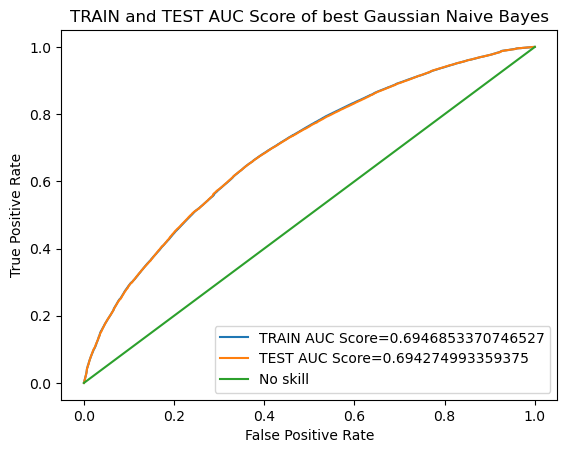

time taken to generate classification report: 18.724501609802246


In [87]:
from sklearn.naive_bayes import GaussianNB
gnb_model = GaussianNB()
t0=time()
gnb_model.fit(X_train, y_train)
print(f"time taken to fit the Gaussian NB model on train data: {time()-t0} s")

t0=time()
classification_report_custom(
    model = gnb_model,
    train_data = X_train,
    train_label = y_train,
    test_data = X_val,
    test_label = y_val,
    model_name="Gaussian Naive Bayes"
)
print(f"time taken to generate classification report: {time()-t0}")

__Summary of Gaussian Naive Bayes:__
- Model is not overfitted but training and test accuracy is very low.